<a href="https://colab.research.google.com/github/saquibali7/VideoFramePrediction/blob/main/Blastocyst10_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt

In [2]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

In [3]:
!pip install -q git+https://github.com/tensorflow/docs
import imageio
from tensorflow_docs.vis import embed
def to_gif(images):
  converted_images = np.clip(images * 255, 0, 255).astype(np.uint8)
  imageio.mimsave('./animation.gif', converted_images, fps=10)
  return embed.embed_file('./animation.gif')

  Preparing metadata (setup.py) ... done


In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
!unzip "/content/drive/MyDrive/Videos_8cell_Blast.zip"

data_path = "/content/Videos_8cell_Blast"
data = os.listdir(data_path)

Archive:  /content/drive/MyDrive/Videos_8cell_Blast.zip
   creating: Videos_8cell_Blast/
  inflating: Videos_8cell_Blast/103.2.avi  
  inflating: Videos_8cell_Blast/128.5.avi  
  inflating: Videos_8cell_Blast/133.4.avi  
  inflating: Videos_8cell_Blast/137.1.avi  
  inflating: Videos_8cell_Blast/143.1.avi  
  inflating: Videos_8cell_Blast/148.1.avi  
  inflating: Videos_8cell_Blast/15.2.avi  
  inflating: Videos_8cell_Blast/153.2.avi  
  inflating: Videos_8cell_Blast/157.4.avi  
  inflating: Videos_8cell_Blast/167.1.avi  
  inflating: Videos_8cell_Blast/170.1.avi  
  inflating: Videos_8cell_Blast/171.1.avi  
  inflating: Videos_8cell_Blast/172.2.avi  
  inflating: Videos_8cell_Blast/174.3.avi  
  inflating: Videos_8cell_Blast/175.2.avi  
  inflating: Videos_8cell_Blast/18.1.avi  
  inflating: Videos_8cell_Blast/184.1.avi  
  inflating: Videos_8cell_Blast/191.1.avi  
  inflating: Videos_8cell_Blast/197.1.avi  
  inflating: Videos_8cell_Blast/198.3.avi  
  inflating: Videos_8cell_Blast/2

In [7]:
print(len(data))

510


In [8]:
import random
random_sample = random.sample(range(0, len(data)), 250)

In [9]:

frames = list()
counting=0
video=0
for idx in random_sample:
  temp=list()
  cap = cv2.VideoCapture(os.path.join(data_path,data[idx]))
  img_count=0
  while(cap.isOpened()):
    ret, frame = cap.read()
    try:
      img = cv2.resize(frame, (256, 256))
      if img_count%3 == 0:
        temp.append(img)
      img_count+=1  
    except:
      break
    if cv2.waitKey(1) & 0xFF == ord('q'):
      break   
  count=0
  video+=1  
  while(count+10 <= len(temp)):
    frames.append(temp[count:count+10])
    count = count+10  
    counting+=1
  cap.release()
  cv2.destroyAllWindows()

In [10]:
frames = np.array(frames)
print(frames.shape)

(3041, 10, 256, 256, 3)


In [11]:
print(video)

250


In [12]:
def return_frames(idx):
  frames=list()
  cap = cv2.VideoCapture(os.path.join(data_path,data[idx]))
  while(cap.isOpened()):
    ret, frame = cap.read()
    try:
      img = cv2.resize(frame, (256, 256))
      frames.append(img)
    except:
      break
    if cv2.waitKey(1) & 0xFF == ord('q'):
      break   
  frames = np.array(frames)  
  cap.release()
  cv2.destroyAllWindows()
  return frames



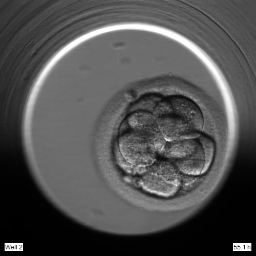

In [13]:
import random
idx = random.randint(0,len(data))
frame = return_frames(idx)
to_gif(frame/255.0)

In [14]:

class CustomDataset(keras.utils.Sequence):
  def __init__(self, data, batch_size):
    self.data = data
    self.batch_size = batch_size

  def __len__(self):
    return (np.ceil(len(self.data) / float(self.batch_size))).astype(int)
  
  def __getitem__(self, idx):
    frames = (self.data[idx * self.batch_size : (idx+1) * self.batch_size]/255.0).astype(np.float16)
    train_x = frames[:, 0:frames.shape[1]-1, :, :]
    train_y = frames[: , 1:frames.shape[1], :, :]
    return train_x, train_y

    return np.array([resize(img, (256, 256, 3)) for img in train_x]), 
    np.array([resize(img, (256, 256, 3)) for img in train_y])


In [15]:
indexes = np.arange(frames.shape[0])
np.random.shuffle(indexes)
train_index = indexes[: int(0.9 * frames.shape[0])]
val_index = indexes[int(0.9 * frames.shape[0]) :]
train_dataset = frames[train_index]
val_dataset = frames[val_index]

In [16]:
batch_size = 1
train_data = CustomDataset(train_dataset,batch_size)
val_data = CustomDataset(val_dataset,batch_size)

In [17]:
count1=0
for idx, (x, y) in enumerate(val_data):
  if idx == 0:
    print(x.shape, y.shape)
  else :
    count1+=1
  

(1, 9, 256, 256, 3) (1, 9, 256, 256, 3)


In [18]:
print(count1)

304


In [19]:
input = layers.Input(shape=(None, *frame.shape[1:]))
x = layers.ConvLSTM2D(
    filters = 64, 
    kernel_size=(5,5),
    padding="same",
    return_sequences=True,    
    activation="relu"
    )(input)

x = layers.BatchNormalization()(x)
x = layers.ConvLSTM2D(
    filters = 64,
    kernel_size=(3,3),
    padding = "same",
    return_sequences = True,
    activation = "relu"
    )(x)

x = layers.BatchNormalization()(x)
x = layers.ConvLSTM2D(
    filters = 64,
    kernel_size=(3,3),
    padding = "same",
    return_sequences = True,
    activation = "relu"
    )(x)

x = layers.BatchNormalization()(x)
x = layers.ConvLSTM2D(
    filters = 64,
    kernel_size = (1,1),
    padding = "same",
    return_sequences = True,
    activation = "relu"
    )(x)

x = layers.BatchNormalization()(x)
x = layers.ConvLSTM2D(
    filters = 64,
    kernel_size = (1,1),
    padding = "same",
    return_sequences = True,
    activation = "relu"
    )(x)    

x = layers.Conv3D(
    filters = 3, 
    kernel_size = (3, 3, 3),
    activation = "sigmoid",
    padding = "same"
    )(x)

model = keras.models.Model(input, x)
model.compile(
    loss=keras.losses.binary_crossentropy,
    optimizer = tf.keras.optimizers.Adam(learning_rate = 0.0000001),
    metrics=['acc']
)

In [20]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, 256, 256,   0         
                             3)]                                 
                                                                 
 conv_lstm2d (ConvLSTM2D)    (None, None, 256, 256, 6  429056    
                             4)                                  
                                                                 
 batch_normalization (BatchN  (None, None, 256, 256, 6  256      
 ormalization)               4)                                  
                                                                 
 conv_lstm2d_1 (ConvLSTM2D)  (None, None, 256, 256, 6  295168    
                             4)                                  
                                                                 
 batch_normalization_1 (Batc  (None, None, 256, 256, 6  256  

In [21]:
early_stopping = keras.callbacks.EarlyStopping(monitor="val_loss", patience = 10)
reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor="val_loss", patience = 5)

In [22]:
import datetime

%load_ext tensorboard
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1)

In [ ]:
model.fit(train_data,
          epochs = 50,
          verbose = 1,
          validation_data = val_data,
          callbacks = [early_stopping, reduce_lr, tensorboard_callback])

Epoch 1/50
2736/2736 [==============================] - 1040s 370ms/step - loss: 0.6939 - acc: 0.2064 - val_loss: 0.6682 - val_acc: 0.1501 - lr: 1.0000e-07
Epoch 2/50
2736/2736 [==============================] - 1013s 370ms/step - loss: 0.6477 - acc: 0.1806 - val_loss: 0.6236 - val_acc: 0.2141 - lr: 1.0000e-07
Epoch 3/50
2736/2736 [==============================] - 1015s 371ms/step - loss: 0.6099 - acc: 0.2108 - val_loss: 0.5875 - val_acc: 0.1885 - lr: 1.0000e-07
Epoch 4/50
2736/2736 [==============================] - 1016s 371ms/step - loss: 0.5801 - acc: 0.2043 - val_loss: 0.5614 - val_acc: 0.1703 - lr: 1.0000e-07
Epoch 5/50
2736/2736 [==============================] - 1015s 371ms/step - loss: 0.5590 - acc: 0.1843 - val_loss: 0.5443 - val_acc: 0.1558 - lr: 1.0000e-07
Epoch 6/50
2736/2736 [==============================] - 1014s 371ms/step - loss: 0.5454 - acc: 0.1592 - val_loss: 0.5328 - val_acc: 0.1371 - lr: 1.0000e-07
Epoch 7/50
2736/2736 [==============================] - 1015s 37

In [ ]:
model.save('/content/drive/MyDrive/framePrediction/model/Blastocyst2frameDrop')

In [ ]:
load_model = tf.keras.models.load_model('/content/drive/MyDrive/framePrediction/model/frame412')

In [ ]:
import random
import matplotlib.pyplot as plt
from math import log10, sqrt
from tqdm import tqdm


def PSNR(expected,Predicted): 
    mse = np.mean((expected - Predicted) ** 2) 
    if(mse == 0): 
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse)) 
    return mse,psnr

In [ ]:
def normalize(sample):
    MIN_H = sample.min()
    MAX_H = sample.max()
    return (sample - MIN_H)/(MAX_H-MIN_H)

In [ ]:
def generate_images(frames):
  # idx = random.randint(0,len(val_x))
  expected = frames[-1]/255.0
  frames = frames[0:9, :, :, :]/255.0
  
  out = load_model.predict(np.expand_dims(frames, axis = 0))
  out = np.squeeze(out, axis = 0)
  out = np.expand_dims(out[-1, ...], axis = 0)
  out = tf.squeeze(out,axis = 0)
  expected = expected.astype(np.float32)

  plt.figure(figsize=(15,15))
  title = ['Ground Truth','Predicted']
  display_list = [expected,out]
  for i in range(2):
        plt.subplot(1,2,i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')

  plt.show()
  mse,psnr = PSNR(expected*255,out*255)
  print("MSE value is {}".format(mse))
  print("PNSR value is {}".format(psnr))
  expected = expected.astype(np.float32)
  ssim = tf.image.ssim(expected, out, max_val=1, filter_size=11,
                          filter_sigma=1.5, k1=0.01, k2=0.03)
  print("SSIM value is {}".format(ssim))

196
1/1 [==============================] - 0s 463ms/step


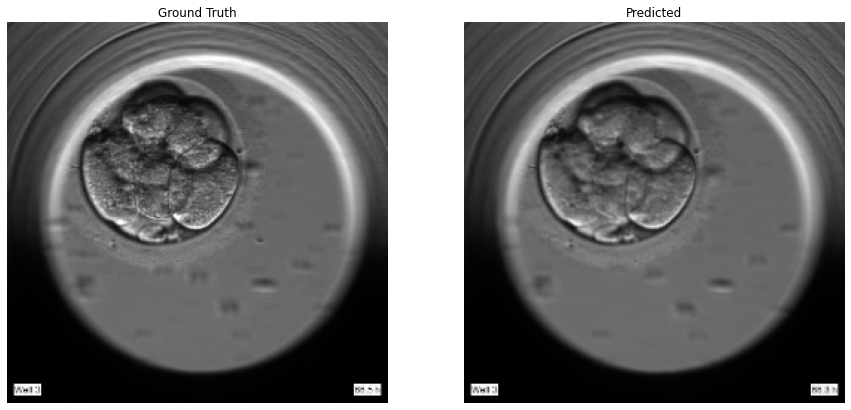

MSE value is 51.01945877075195
PNSR value is 31.053445136917993
SSIM value is 0.9263071417808533


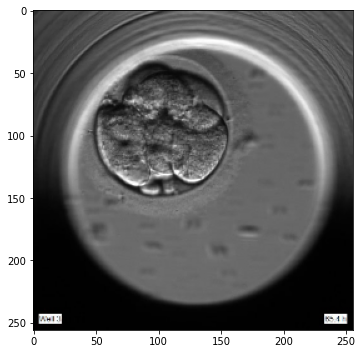

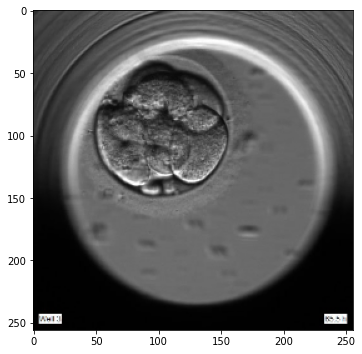

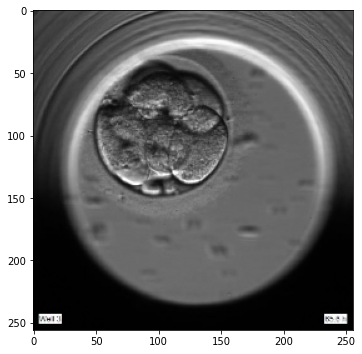

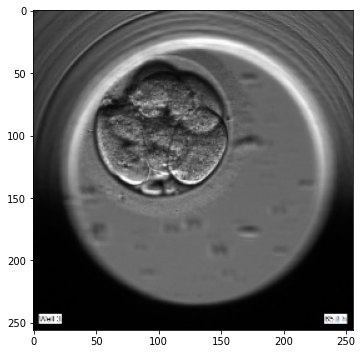

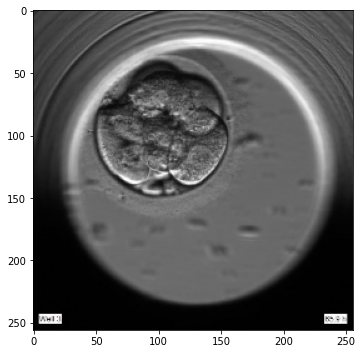

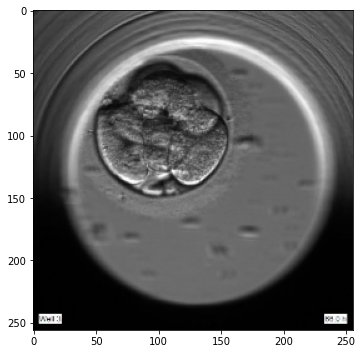

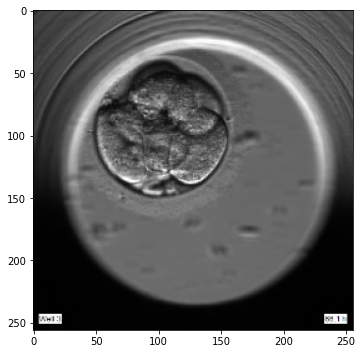

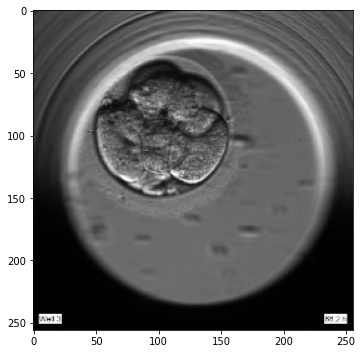

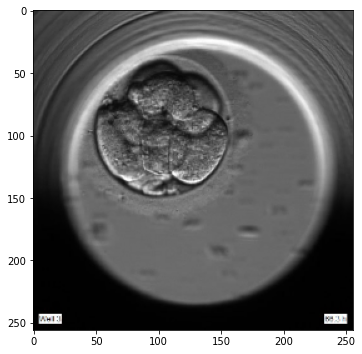

In [ ]:
idx = random.randint(0,len(data))
frames = return_frames(idx)
print(idx)
frames = frames[0:10, :, :, :]
generate_images(frames)
for i in range(9):
  plt.figure(figsize=(20, 20))
  plt.subplot(3,3,i+1)
  expected =frames[i].astype(np.float32)
  plt.imshow(expected/255.0)


In [ ]:
def generate_images(frames):
  expected = frames[-1, ...]/255.0
  frames = frames[0:9, :, :, :]/255.0
  out = load_model.predict(np.expand_dims(frames, axis = 0))
  out = np.squeeze(out, axis = 0)
  output=out
  out = np.expand_dims(out[-1, ...], axis = 0)
  out = tf.squeeze(out,axis = 0)
  expected = expected.astype(np.float32)
  print(output.shape)

  for i in range(8):
    exp = frames[i+1].astype(np.float32)
    ssim = tf.image.ssim(exp,output[i], max_val=1, filter_size=11,
                          filter_sigma=1.5, k1=0.01, k2=0.03)
    mse,psnr = PSNR(exp*255,output[i]*255)
    print("sim , mse and psnr for ",i+1, " th frame s is {}".format(ssim), mse,psnr)

  plt.figure(figsize=(15,15))
  title = ['Ground Truth','Predicted']
  display_list = [expected,out]
  for i in range(2):
        plt.subplot(1,2,i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')

  plt.show()
  mse,psnr = PSNR(expected*255,out*255)
  print("MSE value is {}".format(mse))
  print("PNSR value is {}".format(psnr))
  expected = expected.astype(np.float32)
  ssim = tf.image.ssim(expected, out, max_val=1, filter_size=11,
                          filter_sigma=1.5, k1=0.01, k2=0.03)
  print("SSIM value is {}".format(ssim))

417
(10, 256, 256, 3)
1/1 [==============================] - 1s 513ms/step
(9, 256, 256, 3)
sim , mse and psnr for  1  th frame s is 0.996076762676239 21.401812 34.82629824225866
sim , mse and psnr for  2  th frame s is 0.9921531677246094 18.22931 35.52310152308798
sim , mse and psnr for  3  th frame s is 0.9959902167320251 14.475276 36.52453507898832
sim , mse and psnr for  4  th frame s is 0.9967402815818787 12.82018 37.051862400467634
sim , mse and psnr for  5  th frame s is 0.9970474243164062 12.03622 37.32590258167784
sim , mse and psnr for  6  th frame s is 0.9969556331634521 12.414803 37.19140544071649
sim , mse and psnr for  7  th frame s is 0.9971833825111389 11.498046 37.524563220529515
sim , mse and psnr for  8  th frame s is 0.9972211718559265 11.1558485 37.65577752971001


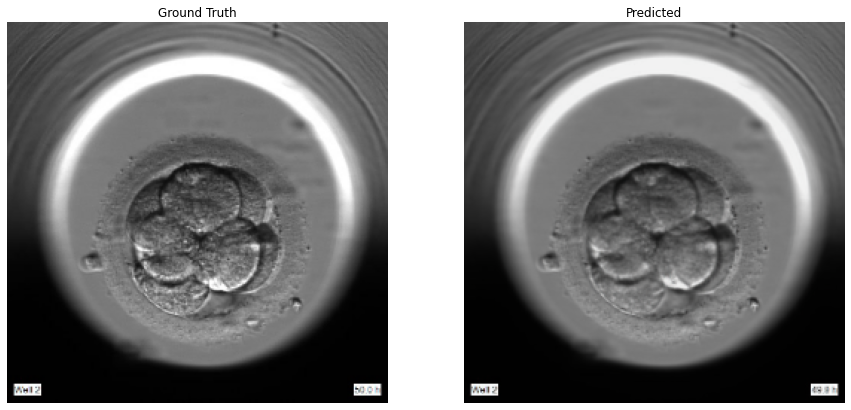

MSE value is 66.98551177978516
PNSR value is 29.870994810701326
SSIM value is 0.9279382824897766


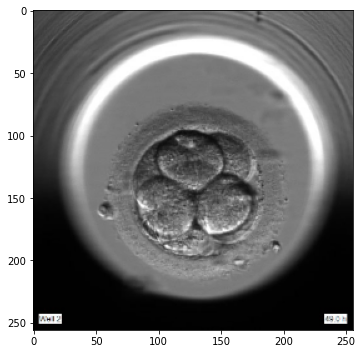

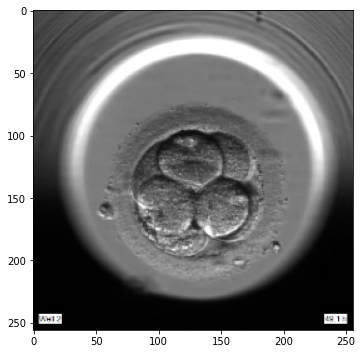

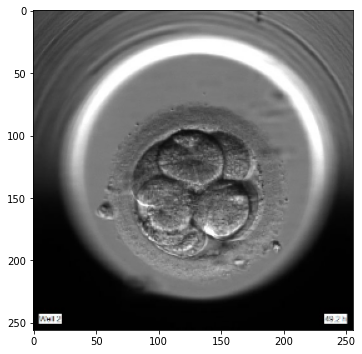

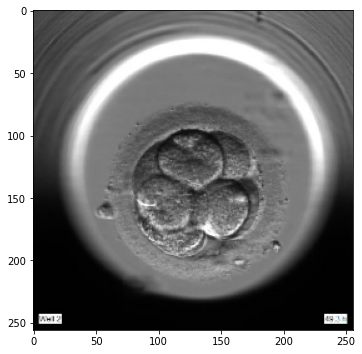

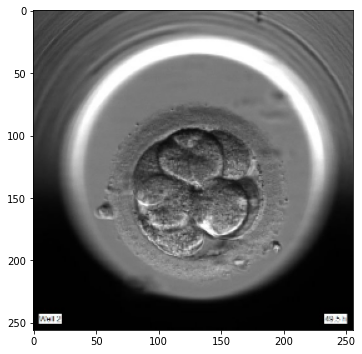

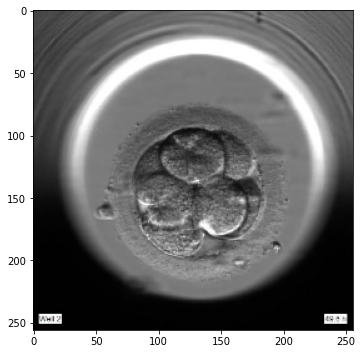

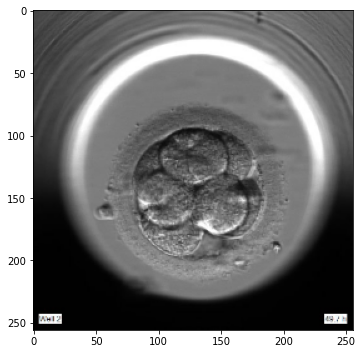

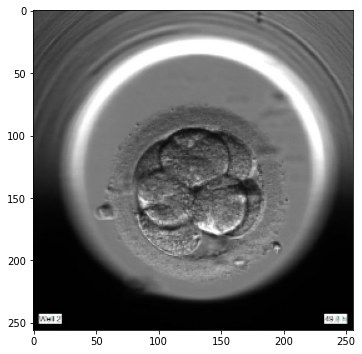

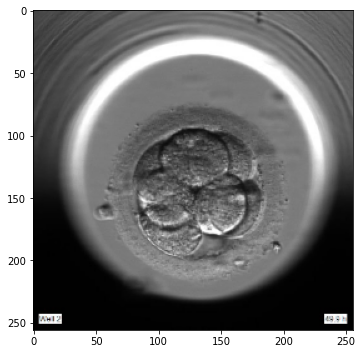

In [ ]:
idx = random.randint(200,len(data))
frames = return_frames(idx)
print(idx)
frames = frames[0:10, :, :, :]
print(frames.shape)
generate_images(frames)
for i in range(9):
  plt.figure(figsize=(20, 20))
  plt.subplot(3,3,i+1)
  expected =frames[i].astype(np.float32)
  plt.imshow(expected/255.0)


(12, 256, 256, 3)
(9, 256, 256, 3)
1/1 [==============================] - 0s 456ms/step
(9, 256, 256, 3)
1/1 [==============================] - 0s 361ms/step
(9, 256, 256, 3)
1/1 [==============================] - 0s 364ms/step
(9, 256, 256, 3)
sim , mse and psnr for  0  th frame s is 0.9389052391052246 48.17162 31.30289114360419
sim , mse and psnr for  1  th frame s is 0.8873920440673828 102.82563 28.009789810156335
sim , mse and psnr for  2  th frame s is 0.8928844332695007 116.48901 27.467953928163436


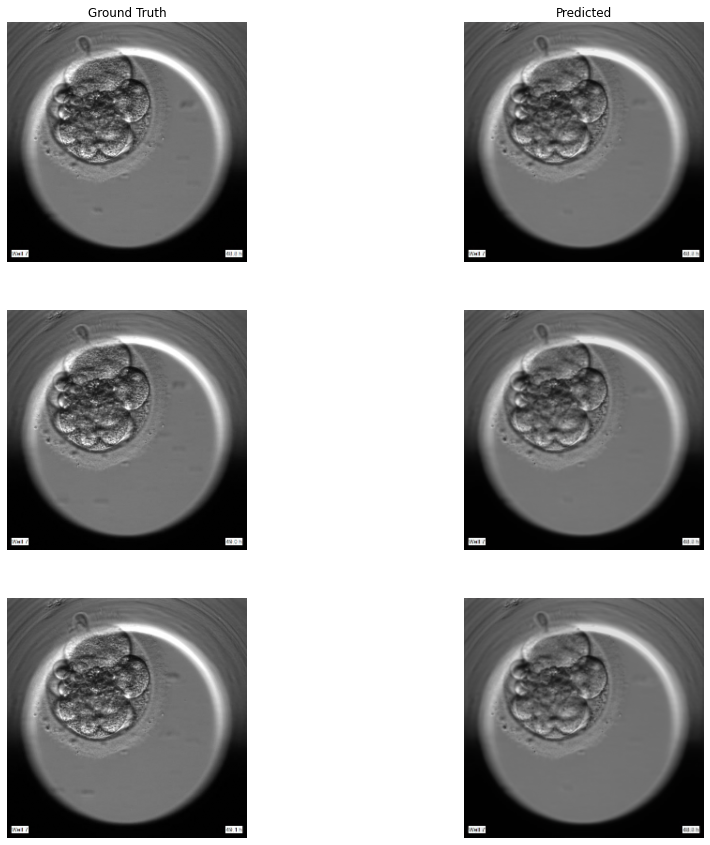

In [ ]:
def generate_images(frames):
  output=[]
  input_idx = 9
  input_frames = frames[0:input_idx, :, :, :]
  print(input_frames.shape)
  for _ in range(3):
    input_frames = np.expand_dims(input_frames, axis = 0)
    out = load_model.predict(input_frames)
    out = np.squeeze(out, axis = 0)
    output.append(out[-1])
    input_frames=out
    print(input_frames.shape)

  total_output=out

  for i in range(3):
    exp = frames[input_idx+i].astype(np.float32)
    ssim = tf.image.ssim(exp,output[i], max_val=1, filter_size=11,
                          filter_sigma=1.5, k1=0.01, k2=0.03)
    mse,psnr = PSNR(exp*255,output[i]*255)
    print("sim , mse and psnr for ",i, " th frame s is {}".format(ssim), mse,psnr)

  plt.figure(figsize=(15,15))
  title = ['Ground Truth','Predicted']
  count1=0
  count2=0
  display_list = [expected,out]
  for i in range(6):
    plt.subplot(3,2,i+1)
    if i==0 or i==1:
      plt.title(title[i])
    if i%2==0:
      plt.imshow(frames[input_idx+count1])
      count1+=1
    else :
      plt.imshow(output[count2])
      count2+=1  
    plt.axis('off')


idx = random.randint(200,len(data))
frames = return_frames(idx)
frames = frames[0:12, :, :, :]
frames = normalize(frames)
print(frames.shape)
generate_images(frames)

  

### Validation Data

In [ ]:
random_sample = random.sample(range(300, len(data)), 20)

In [ ]:
len(random_sample)

20

In [ ]:
validation_sample = list()
for i in random_sample:
  count = 0
  cap= cv2.VideoCapture(os.path.join(data_path,data[i]))
  temp = []
  while(cap.isOpened()):
    ret, frame = cap.read()
    count+=1
    try:
      img = cv2.resize(frame, (256,256))
      temp.append(img)
    except:
      break
    if cv2.waitKey(1) & 0xFF == ord('q'):
      break

  count=0
  while(count+10 <= len(temp)):
    validation_sample.append(temp[count:count+10])
    count = count+10
  
  cap.release()
  cv2.destroyAllWindows()    


In [ ]:
validation_frames = np.array(validation_sample)
print(validation_frames.shape)

(145, 10, 256, 256, 3)


In [ ]:
def validation_testing(frames):
  expected = frames[-1]/255.0
  frames = frames[0:9, :, :, :]/255.0
  
  out = load_model.predict(np.expand_dims(frames, axis = 0))
  out = np.squeeze(out, axis = 0)
  out = np.expand_dims(out[-1, ...], axis = 0)
  out = tf.squeeze(out,axis = 0)
  expected = expected.astype(np.float32)
  
  mse,psnr = PSNR(expected*255,out*255)

  expected = expected.astype(np.float32)
  ssim = tf.image.ssim(expected, out, max_val=1, filter_size=11,
                          filter_sigma=1.5, k1=0.01, k2=0.03)
  return mse, psnr, ssim

In [ ]:
TotalValidationMSE=0
TotalValidationPSNR=0
TotalValidationSSIM=0

for frame in validation_frames:
  mse,psnr,ssim = validation_testing(frame)
  TotalValidationMSE+=mse
  TotalValidationPSNR+=psnr
  TotalValidationSSIM+=ssim


print(f"Validation MSE : {TotalValidationMSE/len(validation_frames)}")
print(f"Validation PSNR: {TotalValidationPSNR/len(validation_frames)}")
print(f"Validation SSIM: {TotalValidationSSIM/len(validation_frames)}")

1/1 [==============================] - 0s 369ms/step
Validation MSE : 54.47507835914349
Validation PSNR: 31.912465674629626
Validation SSIM: 0.9298762679100037
